# Image Processing

## Colorspace
* RGB is old color coding
* HSL and HSV are more closely aligned with the wat human vision actually perceives color

### HSL

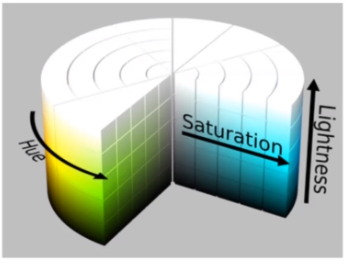

### HSV

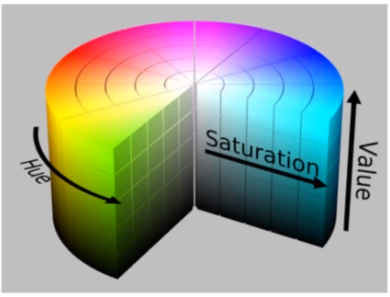

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

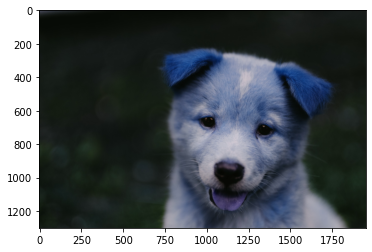

In [2]:
img = cv2.imread('./DATA/00-puppy.jpg')

plt.imshow(img)

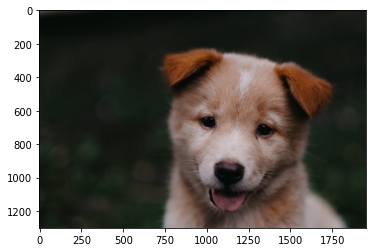

In [3]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.imshow(img)

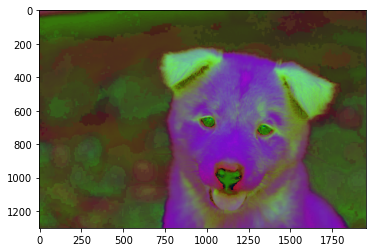

In [4]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

plt.imshow(img)

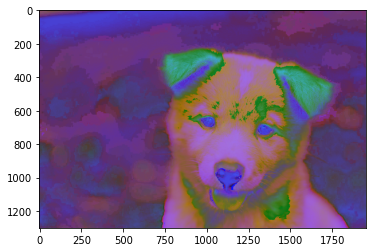

In [5]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)

plt.imshow(img)

## Image Blending
* Blending images is done through the **addWeighted** function that uses both images and combines them.
* new_pixel = a \* pixel_1+1 + b \* pixel_2 + y

In [6]:
img1 = cv2.imread('./DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('./DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)


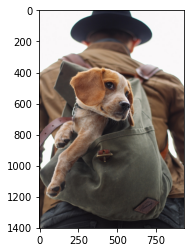

In [7]:
plt.imshow(img1)

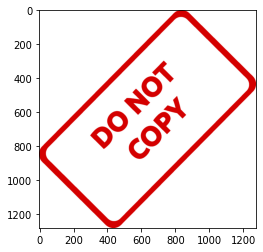

In [8]:
plt.imshow(img2)

In [9]:
img1.shape

(1401, 934, 3)

In [10]:
img2.shape

(1280, 1277, 3)

In [11]:
# BLENDING IMAGES OF THE SAME SIZE

In [12]:
img1 = cv2.resize(img1, (1200,1200))
img2 = cv2.resize(img2, (1200,1200))

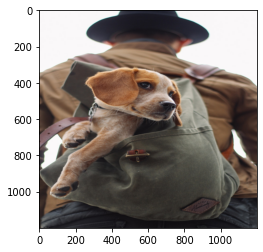

In [13]:
plt.imshow(img1)

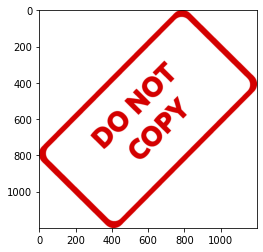

In [14]:
plt.imshow(img2)

In [15]:
blended = cv2.addWeighted(img1, 0.8, img2, 0.5, 0)

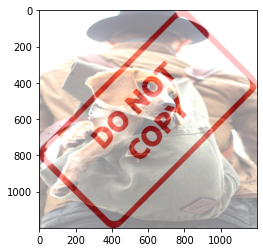

In [16]:
plt.imshow(blended)

### Overlay
* OVERLAY SMALL IMAGE ON TOP OF A LARGER IMAGE (NO BLENDING)
* Numpy reassignment

In [17]:
img1 = cv2.imread('./DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('./DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

In [18]:
img2 = cv2.resize(img2, (600,600))

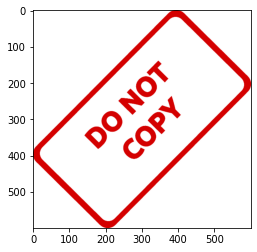

In [19]:
plt.imshow(img2)

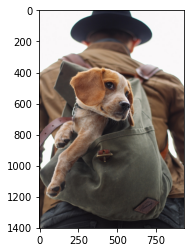

In [20]:
plt.imshow(img1)

In [21]:
large_img = img1
small_img = img2

In [22]:
x_offset = 0
y_offset = 0

In [23]:
x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

In [24]:
large_img[y_offset:y_end, x_offset:x_end] = small_img

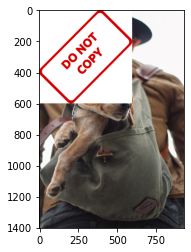

In [25]:
plt.imshow(large_img)

### MASK
* BLEND TOGETHER IMAGES OF DIFFERENT SIZES

In [26]:
img1 = cv2.imread('./DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('./DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

In [27]:
img2 = cv2.resize(img2,(600,600))

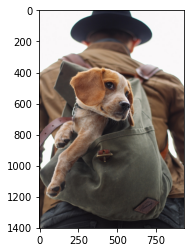

In [28]:
plt.imshow(img1)

In [29]:
img1.shape

(1401, 934, 3)

In [30]:
x_offset = 934 - 600
y_offset = 1401 - 600

In [31]:
img2.shape

(600, 600, 3)

In [32]:
rows, cols, channels = img2.shape

In [33]:
rows

600

In [34]:
cols

600

In [35]:
channels

3

In [36]:
roi = img1[y_offset:1401, x_offset:943]

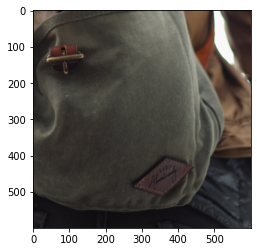

In [37]:
plt.imshow(roi)

In [38]:
img2gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

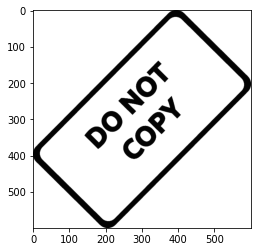

In [39]:
plt.imshow(img2gray, cmap='gray')

In [40]:
mask_inv = cv2.bitwise_not(img2gray)

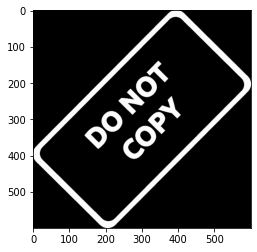

In [41]:
plt.imshow(mask_inv, cmap='gray')

In [42]:
mask_inv.shape

(600, 600)

In [43]:
white_background = np.full(img2.shape, 255, dtype=np.uint8)

In [44]:
white_background.shape

(600, 600, 3)

In [45]:
white_background

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [46]:
bk = cv2.bitwise_or(white_background, white_background, mask=mask_inv)

In [47]:
bk.shape

(600, 600, 3)

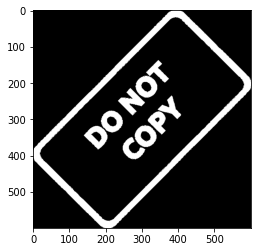

In [48]:
plt.imshow(bk)

In [49]:
fg = cv2.bitwise_or(img2, img2, mask= mask_inv)

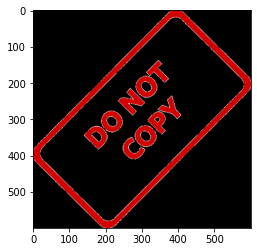

In [50]:
plt.imshow(fg)

In [51]:
final_roi = cv2.bitwise_or(roi, fg)

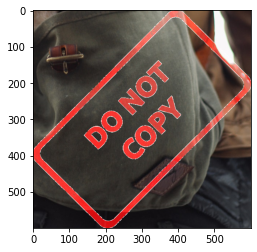

In [52]:
plt.imshow(final_roi)

In [53]:
large_img = img1
small_img = final_roi

In [54]:
large_img[y_offset:y_offset+small_img.shape[0], x_offset:x_offset+small_img.shape[1]] = small_img

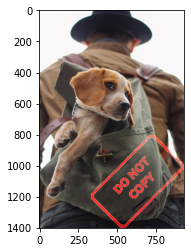

In [55]:
plt.imshow(large_img)

## Coverting a color image to binary
https://en.wikipedia.org/wiki/Thresholding_(image_processing)

In [56]:
img = cv2.imread('./DATA/rainbow.jpg', 0) # make grayscale

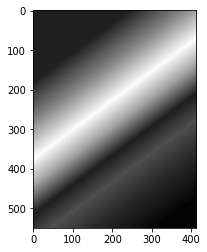

In [57]:
plt.imshow(img, cmap='gray')

In [58]:
# if values are less than 127, those become 0, if not, those become 255
ret,thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)

In [59]:
ret

127.0

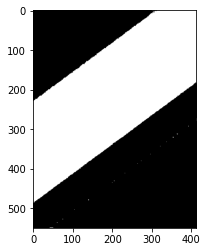

In [60]:
plt.imshow(thresh1,cmap='gray')

In [61]:
img = cv2.imread('./DATA/crossword.jpg', 0)

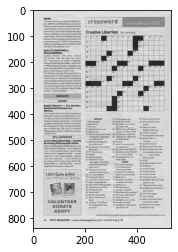

In [62]:
plt.imshow(img, cmap='gray')

In [63]:
def show_pic(img):
  fig = plt.figure(figsize=(15,15))
  ax = fig.add_subplot(111)
  ax.imshow(img, cmap='gray')

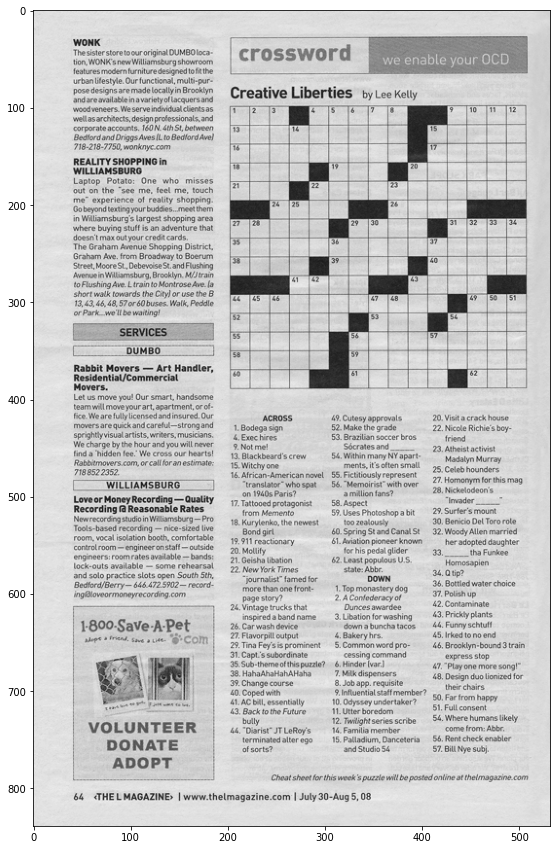

In [64]:
show_pic(img)

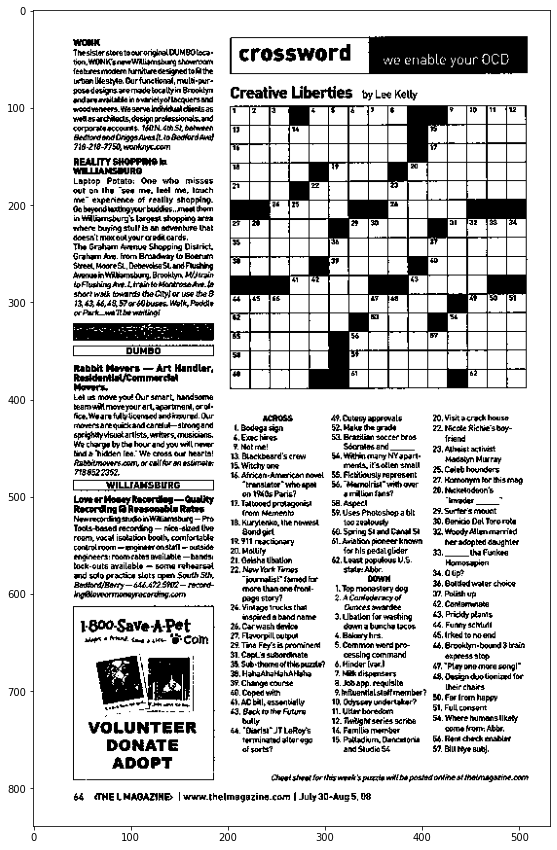

In [65]:
ret, th1 = cv2.threshold(img, 180, 255, cv2.THRESH_BINARY)
show_pic(th1)

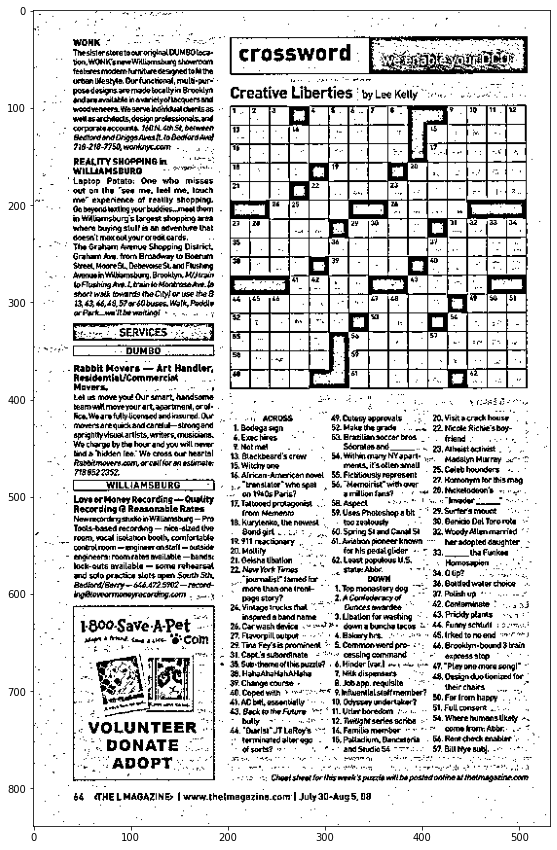

In [66]:
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 8)
show_pic(th2)

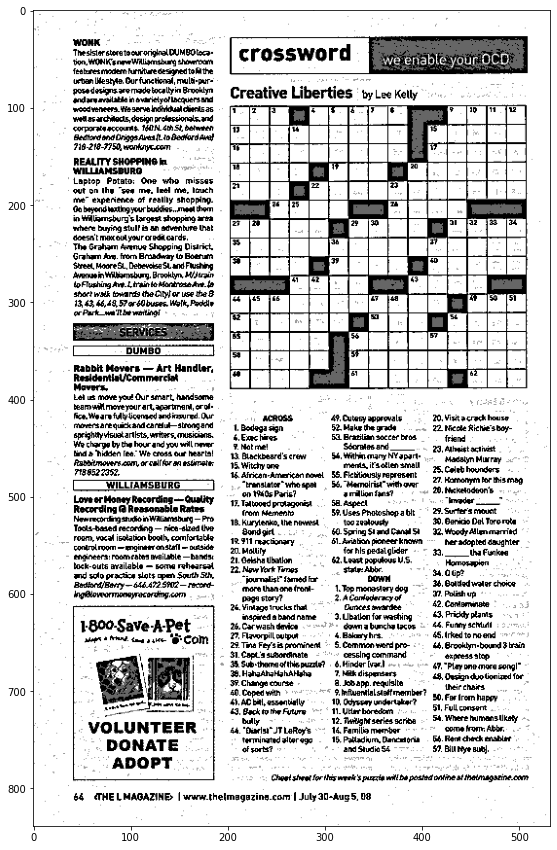

In [67]:
blended = cv2.addWeighted(th1, 0.6, th2, 0.4, 0)
show_pic(blended)

## Blurring and smoothing
* Blurring can remove noise of images

* Gamma correction can be applied to an image to make it appear brighter or darker depending on the Gamma value chosen.
* Kernel Based Filters

* https://www.tutorialspoint.com/dip/concept_of_blurring.htm

In [68]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [69]:
def load_img():
  img = cv2.imread('./DATA/bricks.jpg').astype(np.float32) / 255
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

In [70]:
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img)

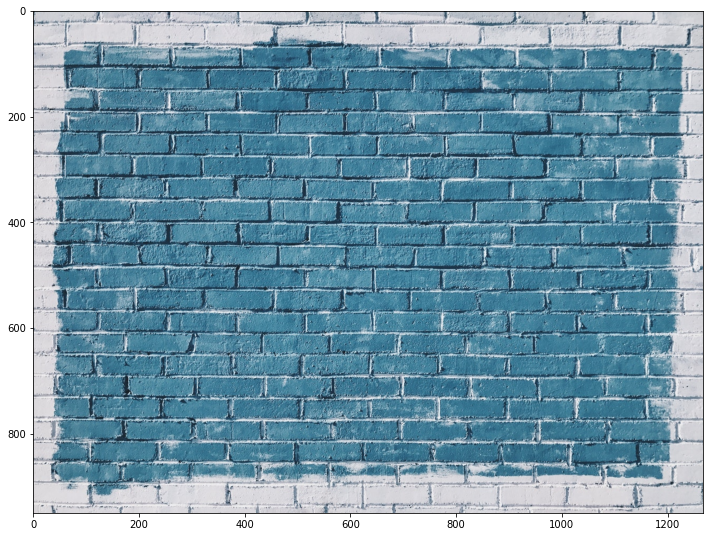

In [71]:
i = load_img()
display_img(i)

In [72]:
gamma = 2

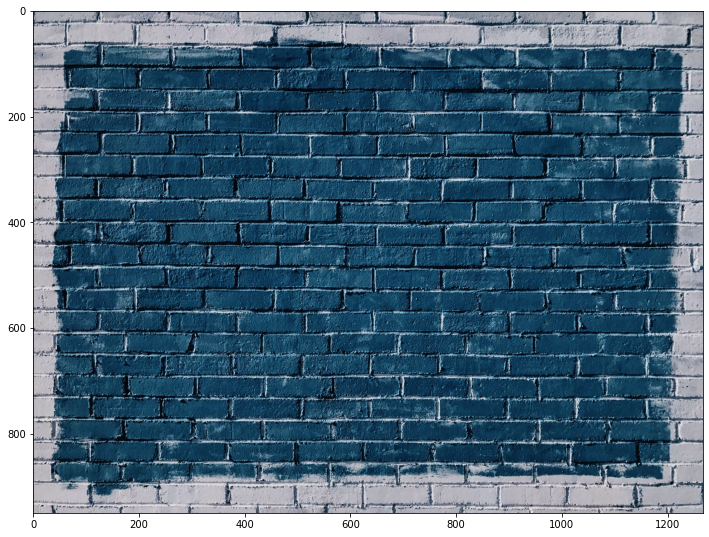

In [73]:
result = np.power(i, gamma)
display_img(result)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


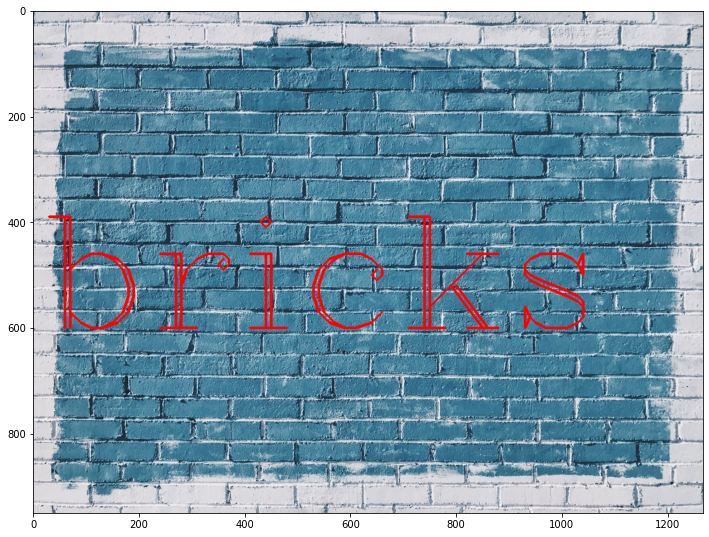

In [74]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='bricks', org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
display_img(img)

In [75]:
kernel = np.ones((5,5), dtype=np.float32) / 25

In [76]:
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

In [77]:
1/ 25

0.04

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


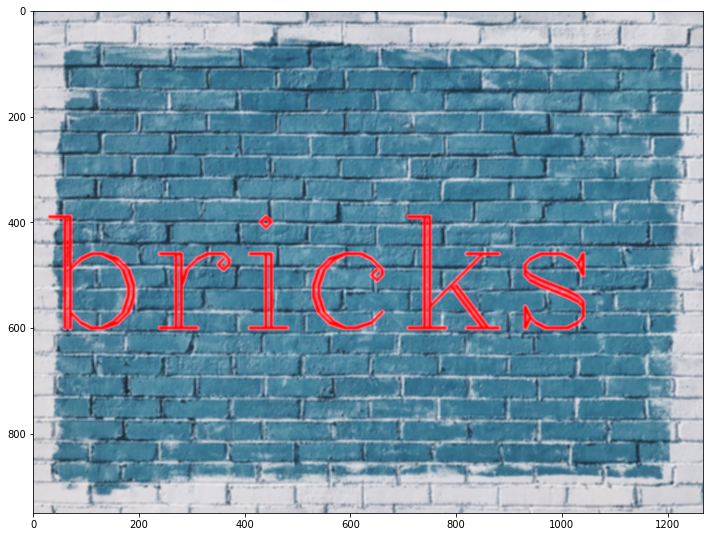

In [78]:
# blurring
dst = cv2.filter2D(img, -1, kernel)
display_img(dst)

In [79]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='bricks', org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


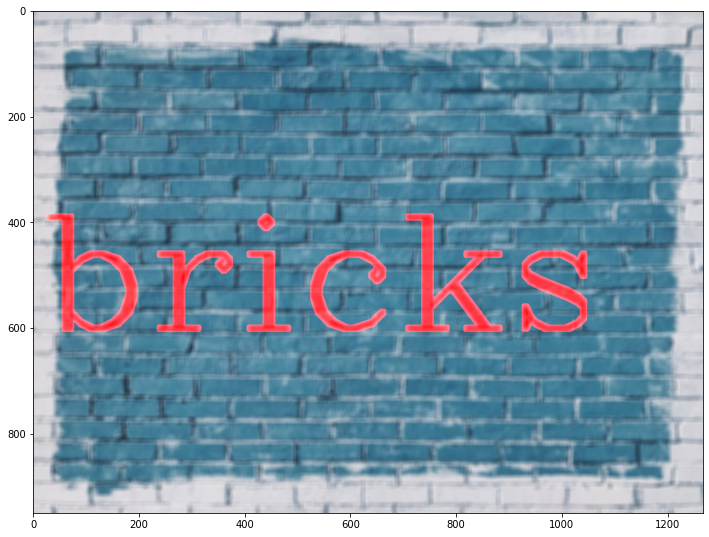

In [80]:
blurred = cv2.blur(img, ksize=(10,10))
display_img(blurred)

In [81]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='bricks', org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


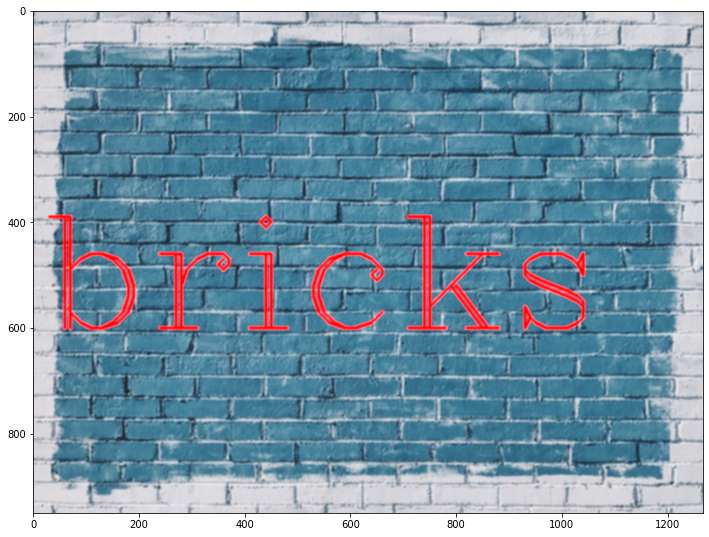

In [82]:
blurred_img = cv2.GaussianBlur(img, (5,5), 10)
display_img(blurred_img)

In [83]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='bricks', org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


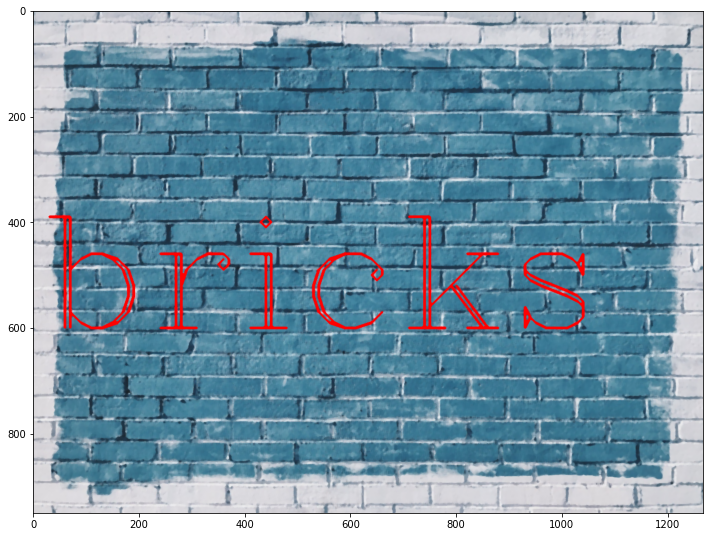

In [84]:
median_result = cv2.medianBlur(img, 5)
display_img(median_result)

In [85]:
img = cv2.imread('./DATA/sammy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

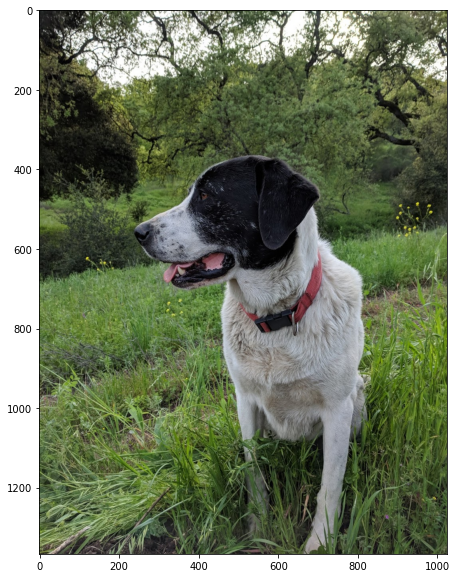

In [86]:
display_img(img)

In [87]:
noise_img = cv2.imread('./DATA/sammy_noise.jpg')

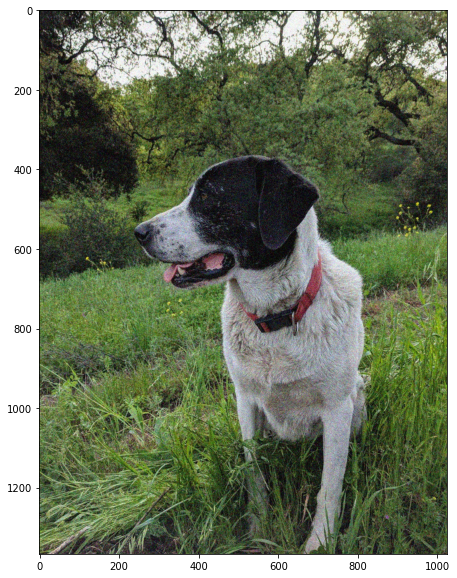

In [88]:
display_img(noise_img)

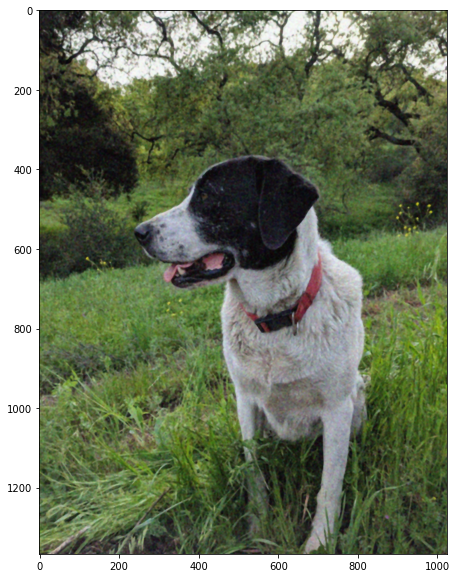

In [89]:
median = cv2.medianBlur(noise_img, 5)
display_img(median)

In [90]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='bricks', org=(10,600), fontFace=font, fontScale=10, color=(255,0,0), thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


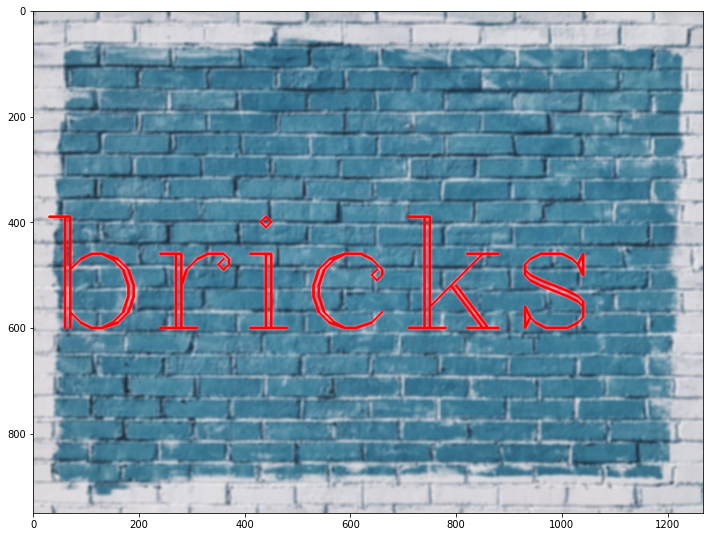

In [91]:
blur = cv2.bilateralFilter(img, 9, 75,75)
display_img(blur)

## Morphological Operator
* Sets of Kernels that can achieve a variety of effects, such as reducing noise.
* Certain operators are very good at reducing black points on a white background (and vice versa)
* Certain operators can also achieve an aerosion and dilation effect that can add or efrode from an existing image.
This effect is most easily seen on text data, so we will practice various morphological operators on some simple white test on a black background.

In [92]:
def load_img():
  blank_img = np.zeros((600,600))
  font = cv2.FONT_HERSHEY_SIMPLEX
  cv2.putText(blank_img, text='ABCDE', org=(50,300), fontFace=font, fontScale=5, color=(255,255,255), thickness=30)
  return blank_img

In [93]:
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img, cmap='gray')

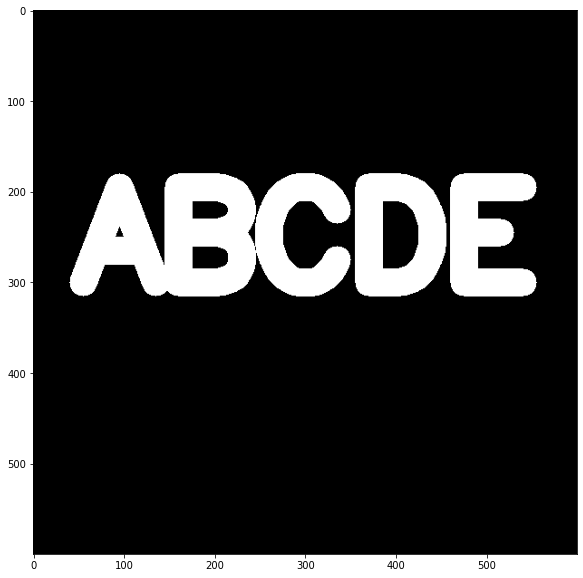

In [94]:
img = load_img()
display_img(img)

### Erode

In [95]:
kernel = np.ones((5,5), dtype=np.uint8)

In [96]:
kernel

array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]], dtype=uint8)

In [97]:
result = cv2.erode(img, kernel, iterations = 4)

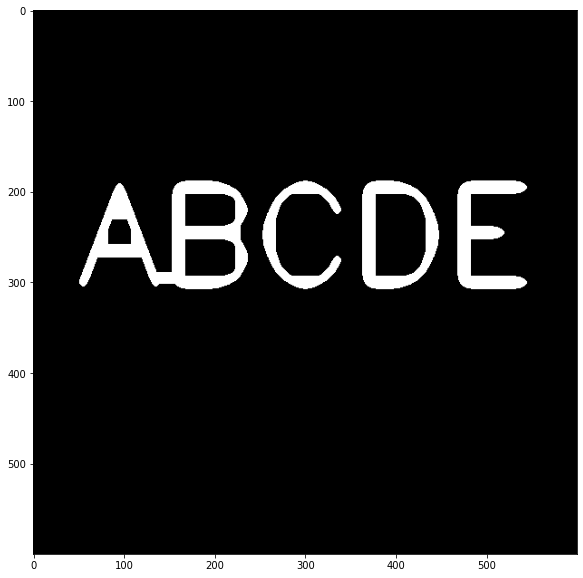

In [98]:
display_img(result)

### Opening

In [99]:
img = load_img()

In [100]:
white_noise = np.random.randint(low=0, high=2, size=(600,600))

In [101]:
white_noise

array([[1, 1, 1, ..., 0, 0, 0],
       [0, 1, 0, ..., 1, 0, 1],
       [1, 1, 0, ..., 1, 1, 0],
       ...,
       [0, 0, 1, ..., 0, 1, 1],
       [1, 1, 0, ..., 0, 1, 1],
       [0, 0, 1, ..., 0, 1, 1]])

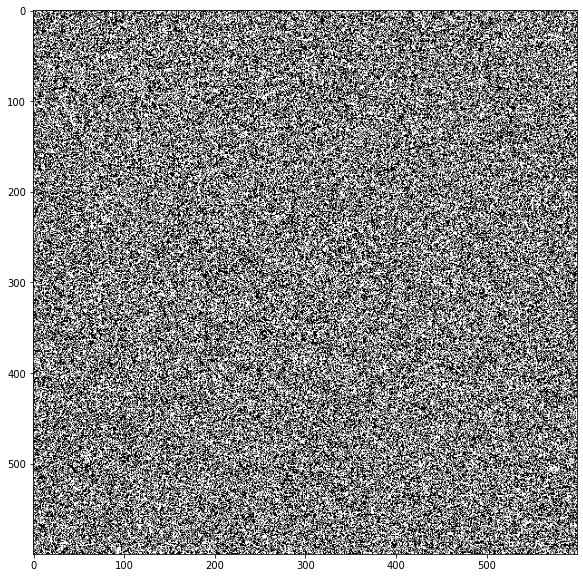

In [102]:
display_img(white_noise)

In [103]:
img.max()

255.0

In [104]:
white_noise = white_noise * 255

In [105]:
white_noise

array([[255, 255, 255, ...,   0,   0,   0],
       [  0, 255,   0, ..., 255,   0, 255],
       [255, 255,   0, ..., 255, 255,   0],
       ...,
       [  0,   0, 255, ...,   0, 255, 255],
       [255, 255,   0, ...,   0, 255, 255],
       [  0,   0, 255, ...,   0, 255, 255]])

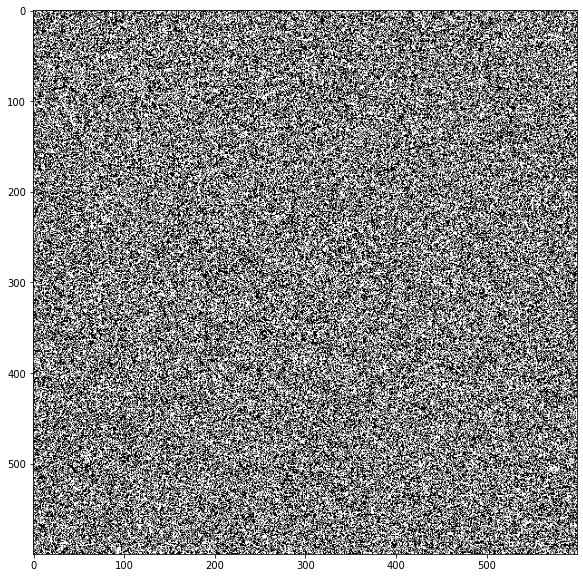

In [106]:
display_img(white_noise)

In [107]:
noise_img = white_noise + img

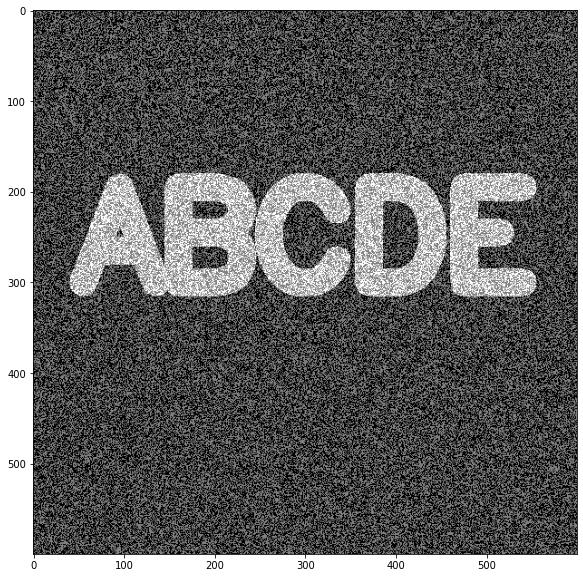

In [108]:
display_img(noise_img)

In [109]:
# 오프닝은 침식 다음 팽창하는 작업에 사용함
opening = cv2.morphologyEx(noise_img, cv2.MORPH_OPEN, kernel)

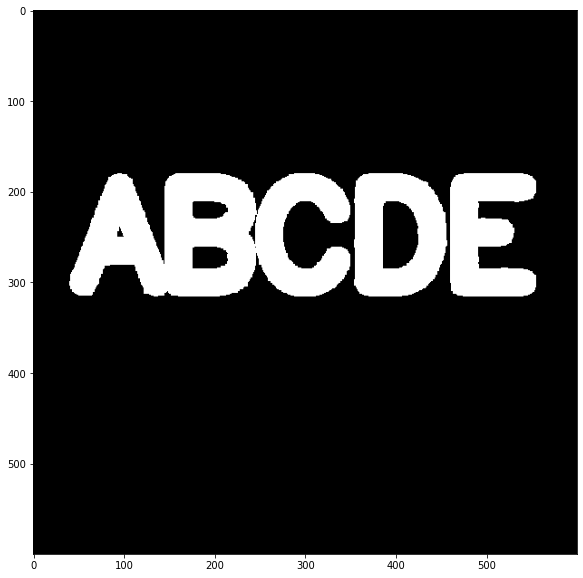

In [110]:
display_img(opening)

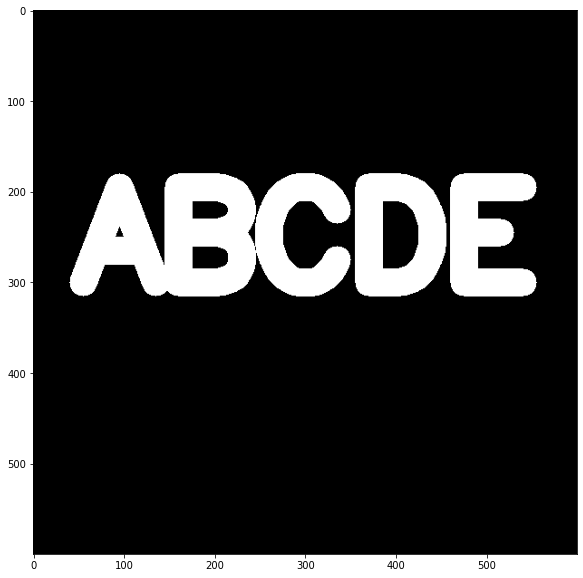

In [111]:
display_img(img)

### Closing

In [112]:
img = load_img()

In [113]:
black_noise = np.random.randint(low=0, high=2, size=(600,600))

In [114]:
black_noise = black_noise * -255

In [115]:
black_noise

array([[   0, -255,    0, ...,    0, -255, -255],
       [   0,    0, -255, ...,    0,    0, -255],
       [-255,    0, -255, ..., -255,    0, -255],
       ...,
       [-255,    0,    0, ..., -255, -255,    0],
       [-255,    0, -255, ..., -255, -255,    0],
       [-255,    0, -255, ..., -255, -255,    0]])

In [116]:
black_noise_img = img + black_noise

In [117]:
black_noise_img

array([[   0., -255.,    0., ...,    0., -255., -255.],
       [   0.,    0., -255., ...,    0.,    0., -255.],
       [-255.,    0., -255., ..., -255.,    0., -255.],
       ...,
       [-255.,    0.,    0., ..., -255., -255.,    0.],
       [-255.,    0., -255., ..., -255., -255.,    0.],
       [-255.,    0., -255., ..., -255., -255.,    0.]])

In [118]:
black_noise_img[black_noise_img == -255] = 0

In [119]:
black_noise_img.min()

0.0

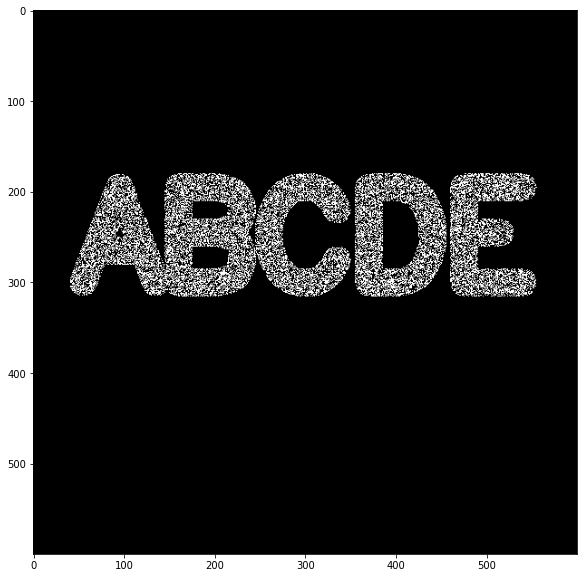

In [120]:
display_img(black_noise_img)

In [121]:
closing = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE, kernel)

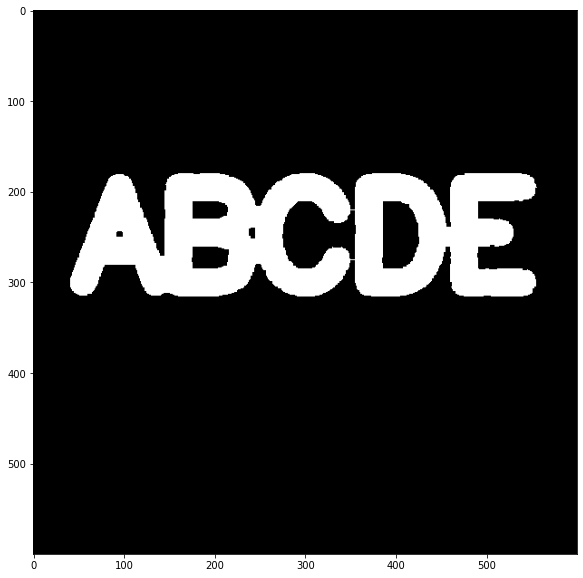

In [122]:
display_img(closing)

### Gradient
* edge detection

In [123]:
img = load_img()

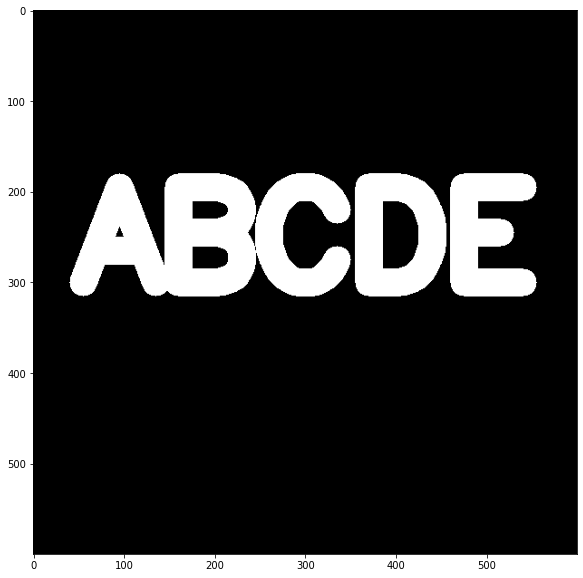

In [124]:
display_img(img)

In [125]:
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)

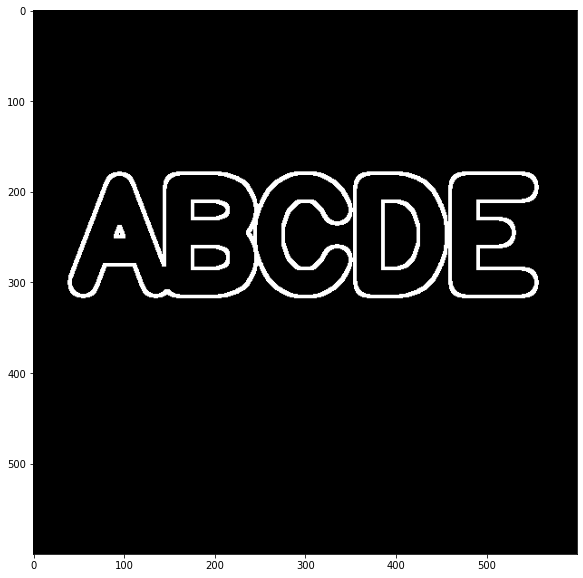

In [126]:
display_img(gradient)

In [127]:
img = cv2.imread('./DATA/sudoku.jpg', 0)

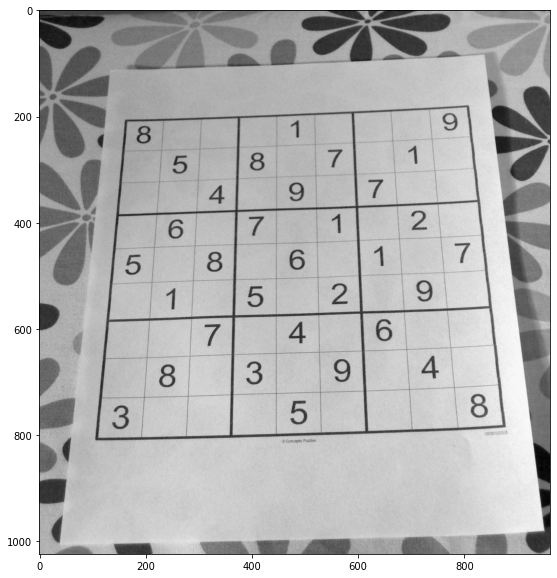

In [128]:
display_img(img)

In [129]:
# x- gradient
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=5)

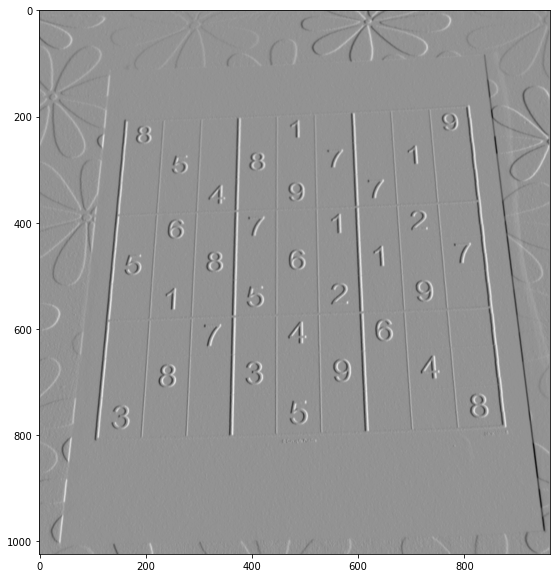

In [130]:
display_img(sobelx)

In [131]:
# y- gradient
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=5)

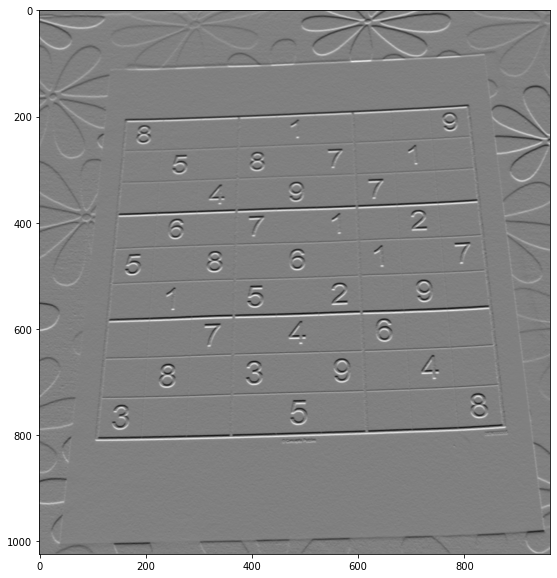

In [132]:
display_img(sobely)

In [133]:
laplacian = cv2.Laplacian(img, cv2.CV_64F)

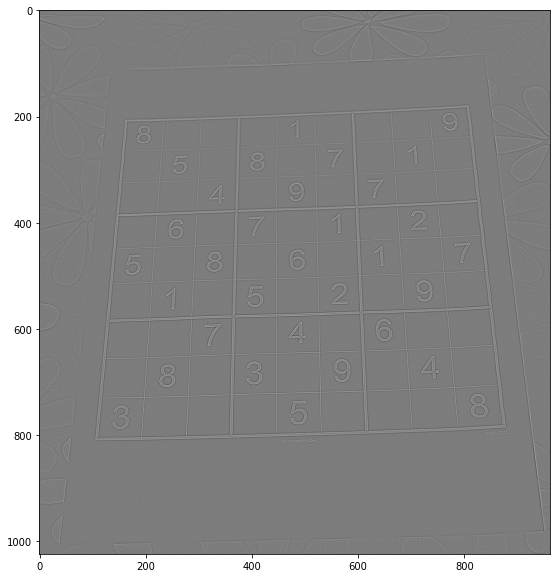

In [134]:
display_img(laplacian)

In [135]:
blended = cv2.addWeighted(src1=sobelx, alpha=0.5, src2=sobely, beta=0.5, gamma=0)

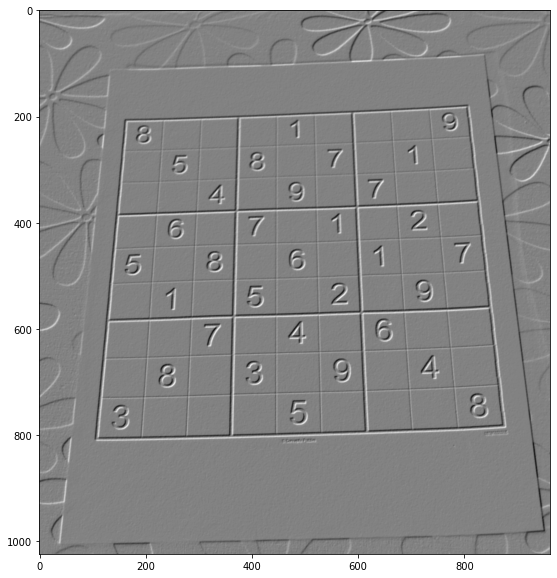

In [136]:
display_img(blended)

In [137]:
ret, th1 = cv2.threshold(img, 100, 255, cv2.THRESH_BINARY)

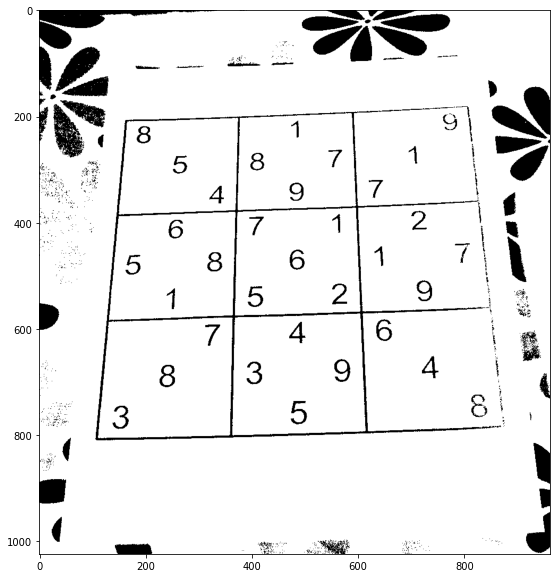

In [138]:
display_img(th1)

In [139]:
kernel = np.ones((4,4), np.uint8)

In [140]:
gradient = cv2.morphologyEx(blended, cv2.MORPH_GRADIENT, kernel)

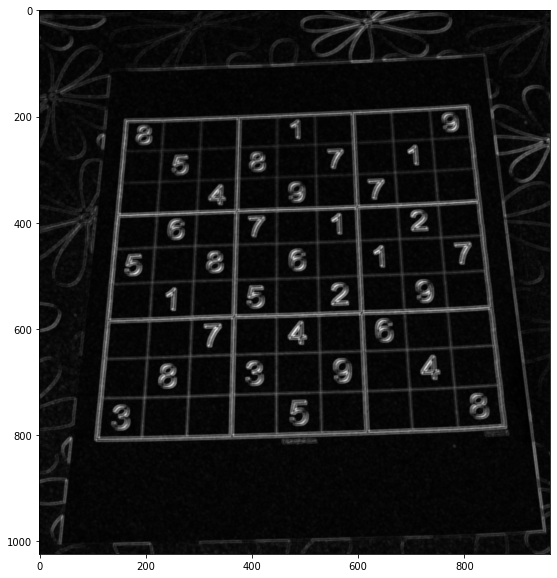

In [141]:
display_img(gradient)

## Histogram

In [142]:
dark_horse = cv2.imread('./DATA/horse.jpg')
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)

rainbow = cv2.imread('./DATA/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread('./DATA/bricks.jpg')
show_bricks = cv2.cvtColor(blue_bricks, cv2.COLOR_BGR2RGB)

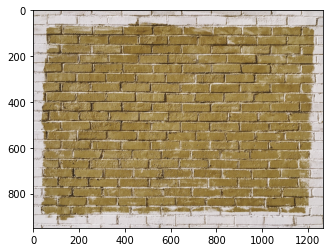

In [143]:
plt.imshow(blue_bricks)

In [144]:
# OPENCV BGR
hist_values = cv2.calcHist([blue_bricks], [0], None, [256], [0,256])

In [145]:
hist_values.shape

(256, 1)

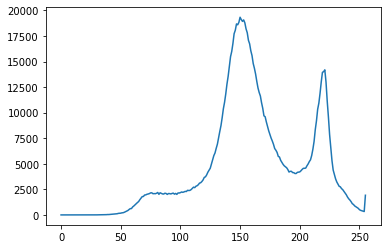

In [146]:
plt.plot(hist_values)

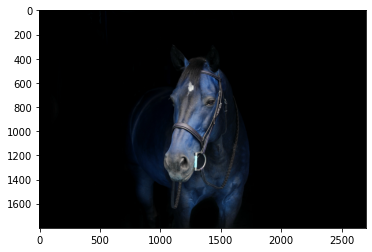

In [147]:
plt.imshow(dark_horse)
hist_values = cv2.calcHist([dark_horse], [0], None, [256], [0,256])

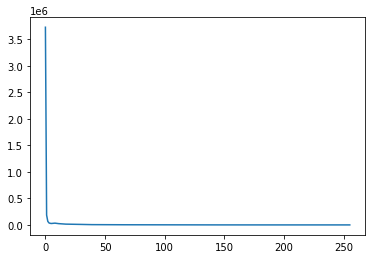

In [148]:
plt.plot(hist_values)

In [149]:
img = blue_bricks

Text(0.5, 1.0, 'HISTOGRAM FORBLUE BRICKS')

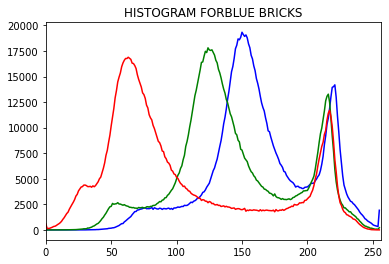

In [150]:
color = ('b', 'g', 'r')

for i, col in enumerate(color):
  histr = cv2.calcHist([img], [i], None, [256], [0,256])
  plt.plot(histr, color=col)
  plt.xlim([0,256])

plt.title('HISTOGRAM FORBLUE BRICKS')

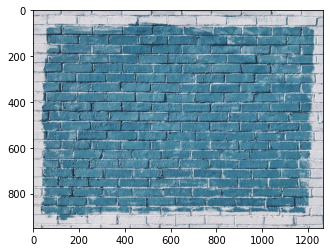

In [151]:
plt.imshow(show_bricks)

Text(0.5, 1.0, 'HISTOGRAM FORBLUE DARK HORSE')

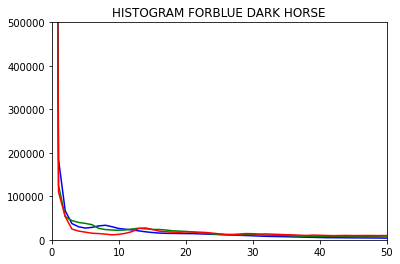

In [152]:
img = dark_horse

color = ('b', 'g', 'r')

for i, col in enumerate(color):
  histr = cv2.calcHist([img], [i], None, [256], [0,256])
  plt.plot(histr, color=col)
  plt.xlim([0,50])
  plt.ylim([0,500000])

plt.title('HISTOGRAM FORBLUE DARK HORSE')

In [153]:
dark_horse.shape

(1800, 2700, 3)

In [154]:
1800*2700*3

14580000

### Histogram Equalization
* resulting in higher contrast



In [155]:
rainbow = cv2.imread('./DATA/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

In [156]:
img = rainbow

In [157]:
img.shape

(550, 413, 3)

In [158]:
mask = np.zeros(img.shape[:2], np.uint8)

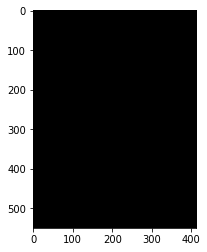

In [160]:
plt.imshow(mask, cmap='gray')

In [161]:
mask[300:400, 100:400] = 255

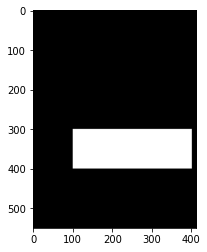

In [162]:
plt.imshow(mask, cmap='gray')

In [165]:
masked_img = cv2.bitwise_and(img, img, mask=mask)

In [166]:
show_mask_img = cv2.bitwise_and(show_rainbow, show_rainbow, mask=mask)

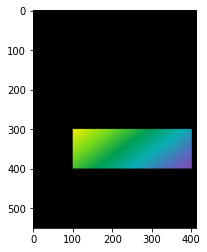

In [167]:
plt.imshow(show_mask_img)

In [168]:
hist_mask_values_red = cv2.calcHist([rainbow], channels=[2], mask=mask, histSize=[256], ranges=[0,256])

In [169]:
hist_values_red = cv2.calcHist([rainbow], channels=[2], mask=None, histSize=[256], ranges=[0,256])

Text(0.5, 1.0, 'RED HISTOGRAM FOR MASKED RAINBOW')

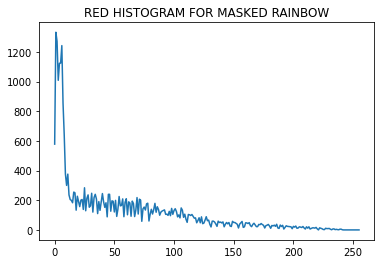

In [170]:
plt.plot(hist_mask_values_red)
plt.title('RED HISTOGRAM FOR MASKED RAINBOW')

Text(0.5, 1.0, 'RED HISTOGRAM FOR MASKED RAINBOW')

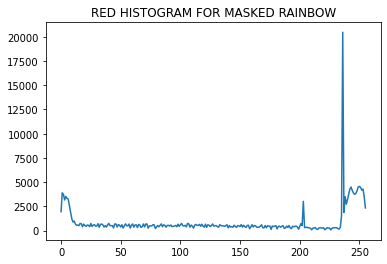

In [171]:
plt.plot(hist_values_red)
plt.title('RED HISTOGRAM FOR MASKED RAINBOW')

In [172]:
gorilla = cv2.imread('./DATA/gorilla.jpg', 0)

In [173]:
def display(img, cmap=None):
  fig = plt.figure(figsize=(10,8))
  ax = fig.add_subplot(111)
  ax.imshow(img, cmap)

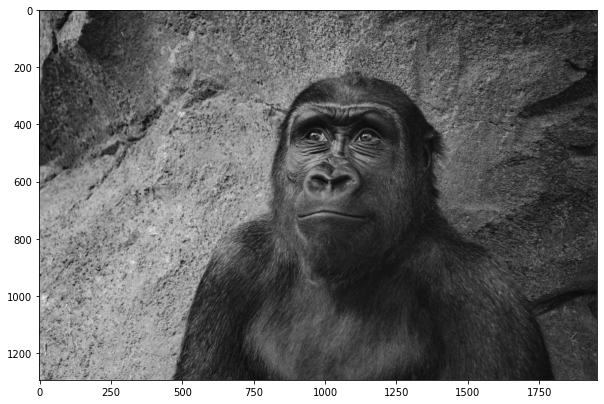

In [174]:
display(gorilla, cmap='gray')

In [175]:
gorilla.shape

(1295, 1955)

In [176]:
hist_values = cv2.calcHist([gorilla], [0], None, [256], [0,256])

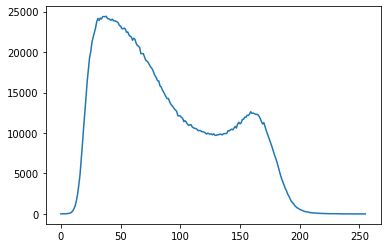

In [177]:
plt.plot(hist_values)

In [178]:
eq_gorilla = cv2.equalizeHist(gorilla)

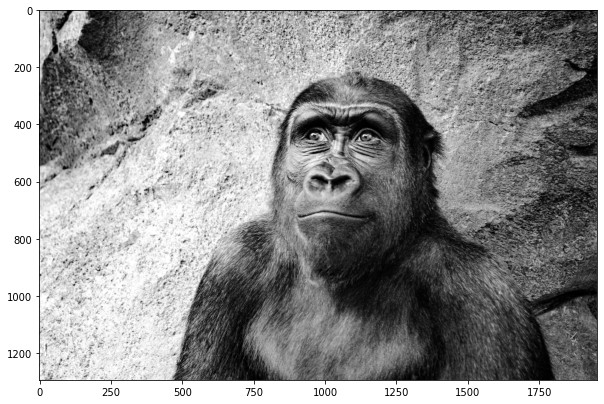

In [179]:
display(eq_gorilla, 'gray')

In [180]:
hist_values = cv2.calcHist([eq_gorilla], [0], None, [256], [0,256])

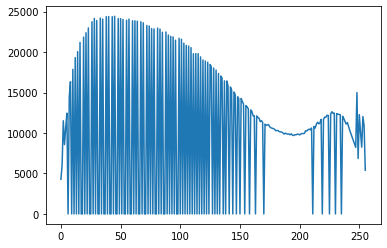

In [181]:
plt.plot(hist_values)

In [182]:
color_gorilla = cv2.imread('./DATA/gorilla.jpg')

In [183]:
show_gorilla = cv2.cvtColor(color_gorilla, cv2.COLOR_BGR2RGB)

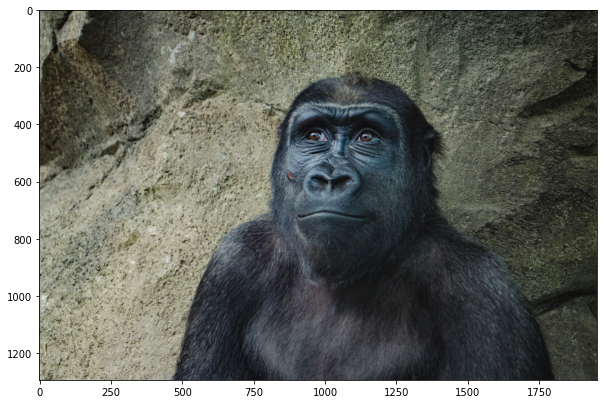

In [184]:
display(show_gorilla)

In [187]:
hsv = cv2.cvtColor(color_gorilla, cv2.COLOR_BGR2HSV)

In [189]:
hsv[:,:,2].min()

1

In [190]:
hsv[:,:,2] = cv2.equalizeHist(hsv[:,:,2])

In [191]:
eq_color_gorilla = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)

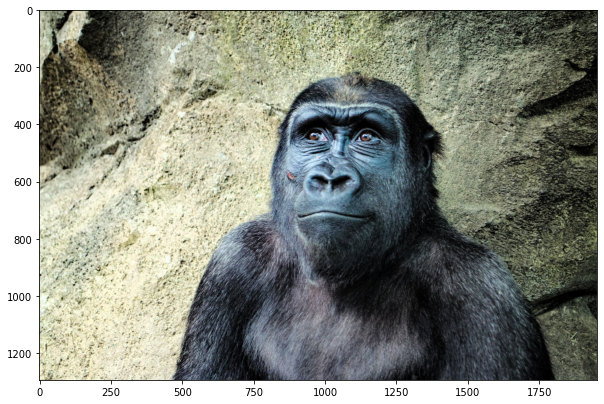

In [192]:
display(eq_color_gorilla)